## Capstone Project- Customer Churn (Banking Sector) Institute of Data 2022

### 1.Introduction
####    •	What is Customer Churn?
####    •	How can Customer Churn be reduced?¶
####    •	What are my objectives
### 2.Importing necessary Libraries
### 3.Loading Data
### 4.Exploratory Data Analysis/Understanding Data
### 5. Manipulating Data
### 6. Data visualization with respect to target variable
### 7. Data Preprocessing/feature engineering 
### 8.Machine Learning Model Evaluations and Predictions


### Importing necessary Libraries

In [1]:
### Importing necessary Libraries

import pandas as pd
import numpy as np
import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.graph_objs as go
import cufflinks as cf

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import BaggingClassifier

from mlxtend.classifier import StackingClassifier

from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import xgboost as xgb
from sklearn.metrics import mean_squared_error

from sklearn.model_selection import GridSearchCV
from catboost import CatBoostClassifier

from xgboost import XGBClassifier
from catboost import CatBoostClassifier
from sklearn import metrics
from sklearn.metrics import roc_curve
from sklearn.metrics import accuracy_score, roc_auc_score, precision_recall_curve, roc_curve, auc
from sklearn.metrics import recall_score, confusion_matrix, precision_score, f1_score, accuracy_score, classification_report

from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, roc_auc_score, precision_recall_curve, roc_curve, auc
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import average_precision_score
from sklearn.metrics import mean_squared_error,confusion_matrix, precision_score, recall_score, auc,roc_curve
from sklearn import ensemble, linear_model, neighbors, svm, tree, neural_network
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.model_selection import cross_validate
from sklearn.pipeline import make_pipeline
from sklearn import svm,model_selection, tree, linear_model, neighbors, naive_bayes, ensemble, discriminant_analysis, gaussian_process
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier

from termcolor import colored
import missingno as msno 

import colorama
from colorama import Fore, Style  # maakes strings colored
from termcolor import colored, cprint


import pandas_profiling

import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.warn("this will not show")



### Loading and Reading Data

In [2]:
# read file
df = pd.read_csv('Churn_Modelling.csv')
df.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


In [3]:
df.tail()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
9995,9996,15606229,Obijiaku,771,France,Male,39,5,0.00,2,1,0,96270.64,0
9996,9997,15569892,Johnstone,516,France,Male,35,10,57369.61,1,1,1,101699.77,0
9997,9998,15584532,Liu,709,France,Female,36,7,0.00,1,0,1,42085.58,1
9998,9999,15682355,Sabbatini,772,Germany,Male,42,3,75075.31,2,1,0,92888.52,1
9999,10000,15628319,Walker,792,France,Female,28,4,130142.79,1,1,0,38190.78,0


In [4]:
df.shape

(10000, 14)

In [5]:
df.columns

Index(['RowNumber', 'CustomerId', 'Surname', 'CreditScore', 'Geography',
       'Gender', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'HasCrCard',
       'IsActiveMember', 'EstimatedSalary', 'Exited'],
      dtype='object')

In [6]:
df.dtypes

RowNumber            int64
CustomerId           int64
Surname             object
CreditScore          int64
Geography           object
Gender              object
Age                  int64
Tenure               int64
Balance            float64
NumOfProducts        int64
HasCrCard            int64
IsActiveMember       int64
EstimatedSalary    float64
Exited               int64
dtype: object

### The target that we will use for data exploration is Exited='Churn'

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   RowNumber        10000 non-null  int64  
 1   CustomerId       10000 non-null  int64  
 2   Surname          10000 non-null  object 
 3   CreditScore      10000 non-null  int64  
 4   Geography        10000 non-null  object 
 5   Gender           10000 non-null  object 
 6   Age              10000 non-null  int64  
 7   Tenure           10000 non-null  int64  
 8   Balance          10000 non-null  float64
 9   NumOfProducts    10000 non-null  int64  
 10  HasCrCard        10000 non-null  int64  
 11  IsActiveMember   10000 non-null  int64  
 12  EstimatedSalary  10000 non-null  float64
 13  Exited           10000 non-null  int64  
dtypes: float64(2), int64(9), object(3)
memory usage: 1.1+ MB


In [8]:
df.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
RowNumber,10000.0,NaN,NaN,NaN,5000.5,2886.89568,1.0,2500.75,5000.5,7500.25,10000.0
CustomerId,10000.0,NaN,NaN,NaN,15690940.5694,71936.186123,15565701.0,15628528.25,15690738.0,15753233.75,15815690.0
Surname,10000,2932,Smith,32,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CreditScore,10000.0,NaN,NaN,NaN,650.5288,96.653299,350.0,584.0,652.0,718.0,850.0
Geography,10000,3,France,5014,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Gender,10000,2,Male,5457,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Age,10000.0,NaN,NaN,NaN,38.9218,10.487806,18.0,32.0,37.0,44.0,92.0
Tenure,10000.0,NaN,NaN,NaN,5.0128,2.892174,0.0,3.0,5.0,7.0,10.0
Balance,10000.0,NaN,NaN,NaN,76485.889288,62397.405202,0.0,0.0,97198.54,127644.24,250898.09
NumOfProducts,10000.0,NaN,NaN,NaN,1.5302,0.581654,1.0,1.0,1.0,2.0,4.0


In [9]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
RowNumber,10000.0,5.000500e+03,2886.895680,1.00,2500.75,5.000500e+03,7.500250e+03,10000.00
CustomerId,10000.0,1.569094e+07,71936.186123,15565701.00,15628528.25,1.569074e+07,1.575323e+07,15815690.00
CreditScore,10000.0,6.505288e+02,96.653299,350.00,584.00,6.520000e+02,7.180000e+02,850.00
Age,10000.0,3.892180e+01,10.487806,18.00,32.00,3.700000e+01,4.400000e+01,92.00
Tenure,10000.0,5.012800e+00,2.892174,0.00,3.00,5.000000e+00,7.000000e+00,10.00
Balance,10000.0,7.648589e+04,62397.405202,0.00,0.00,9.719854e+04,1.276442e+05,250898.09
NumOfProducts,10000.0,1.530200e+00,0.581654,1.00,1.00,1.000000e+00,2.000000e+00,4.00
HasCrCard,10000.0,7.055000e-01,0.455840,0.00,0.00,1.000000e+00,1.000000e+00,1.00
IsActiveMember,10000.0,5.151000e-01,0.499797,0.00,0.00,1.000000e+00,1.000000e+00,1.00
EstimatedSalary,10000.0,1.000902e+05,57510.492818,11.58,51002.11,1.001939e+05,1.493882e+05,199992.48


In [10]:
df.isnull().sum()

RowNumber          0
CustomerId         0
Surname            0
CreditScore        0
Geography          0
Gender             0
Age                0
Tenure             0
Balance            0
NumOfProducts      0
HasCrCard          0
IsActiveMember     0
EstimatedSalary    0
Exited             0
dtype: int64

In [11]:
#renaming column 'Exited':'Churn', 'Geography':'Country', 'IsActiveMember':'CurrentMember', 'EstimatedSalary': 'Salary'
df.rename(columns = {'Exited':'Churn', 'Geography':'Countries', 'IsActiveMember':'CurrentMember', 'EstimatedSalary': 'Salary'}, inplace = True)

<Figure size 288x432 with 0 Axes>

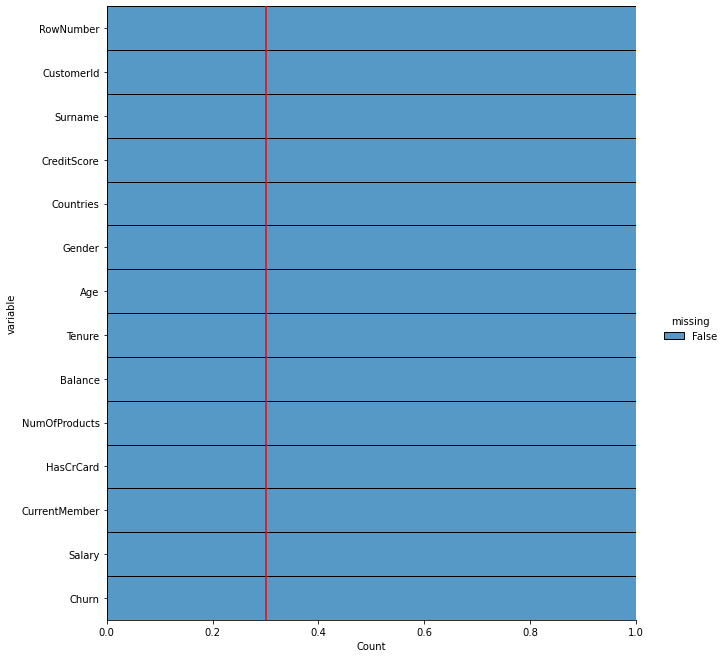

In [12]:
plt.figure(figsize=(4, 6))

sns.displot(data=df.isnull().melt(value_name="missing"),
            y="variable",
            hue="missing",
            multiple="fill",
            height=9.25)

plt.axvline(0.3, color="r");

#### There is no missing data

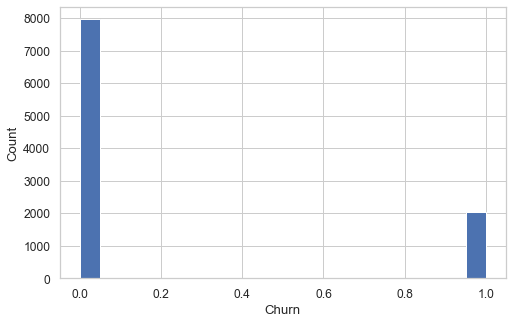

In [13]:
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(
    df['Churn'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Churn', ylabel='Count');

### We can remove the columns of "rownumber", "customerid", "surname" from the given dataset since they do NOT have any contribution to classification in our analysis.

In [14]:
df.drop(["RowNumber", "CustomerId", "Surname"], axis=1, inplace=True)

In [15]:
df.columns

Index(['CreditScore', 'Countries', 'Gender', 'Age', 'Tenure', 'Balance',
       'NumOfProducts', 'HasCrCard', 'CurrentMember', 'Salary', 'Churn'],
      dtype='object')

In [16]:
df.head()

,CreditScore,Countries,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,CurrentMember,Salary,Churn
0,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


In [17]:
categorical = df.select_dtypes('object').columns
categorical

Index(['Countries', 'Gender'], dtype='object')

In [18]:
numerical = df.drop(['Churn'], axis=1).select_dtypes('number').columns
numerical

Index(['CreditScore', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'HasCrCard',
       'CurrentMember', 'Salary'],
      dtype='object')

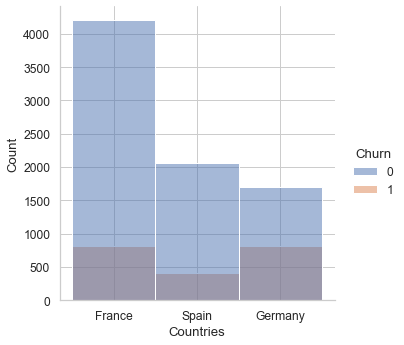

In [19]:
sns.displot(df, x="Countries", hue="Churn")

Text(0.5, 1.0, '# of Customers by their tenure')

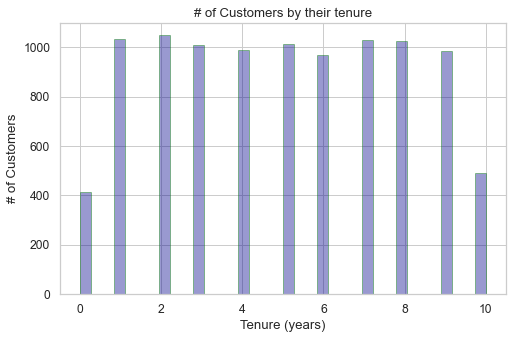

In [20]:
ax = sns.distplot(df['Tenure'], hist=True, kde=False, 
             bins=int(180/5), color = 'darkblue', 
             hist_kws={'edgecolor':'green'},
             kde_kws={'linewidth': 4})
ax.set_ylabel('# of Customers')
ax.set_xlabel('Tenure (years)')
ax.set_title('# of Customers by their tenure')


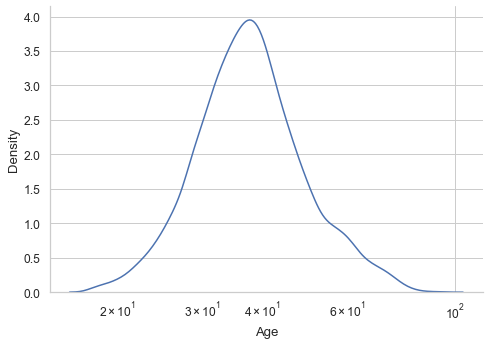

In [21]:
sns.displot(
  data=df,
  x="Age",
  kind="kde",
  aspect=1.4,
  log_scale=10
  )

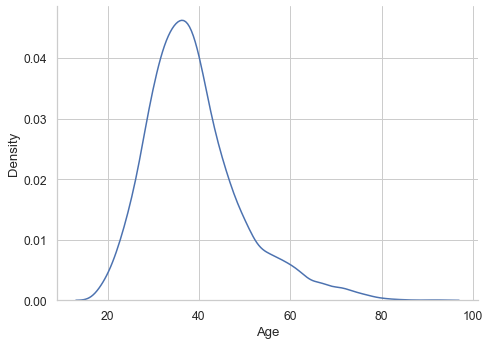

In [22]:
sns.displot(
  data=df,
  x="Age",
  kind="kde",
  aspect=1.4
  )

Age 

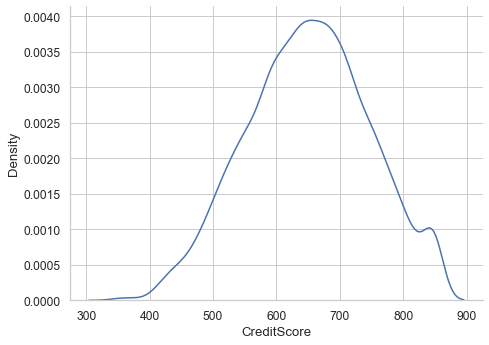

In [23]:
sns.displot(
  data=df,
  x="CreditScore",
  kind="kde",
  aspect=1.4
  )

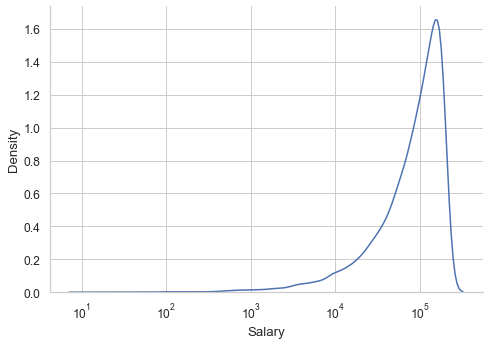

In [24]:
sns.displot(
  data=df,
  x="Salary",
  kind="kde",
  aspect=1.4,
  log_scale=10
  )

In [25]:
### Customers' salaries are skewed to the left. Most of the customers are high earners!

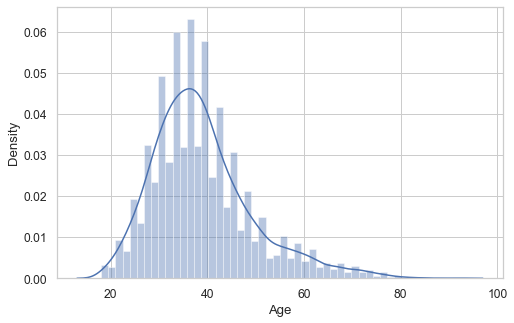

In [26]:
age=df['Age']
sns.distplot(age)         
plt.show()

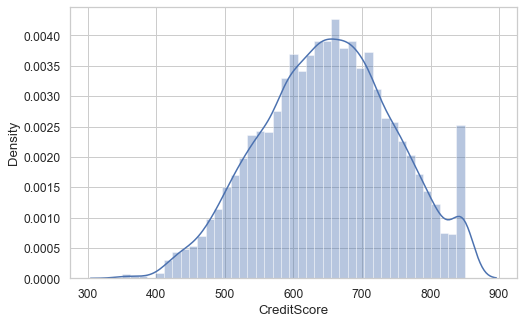

In [27]:
creditscore=df['CreditScore']
sns.distplot(creditscore)         
plt.show()

### distribution of credit score (above) in more of a normal distribution, though there is a few on the higher end of credit score.

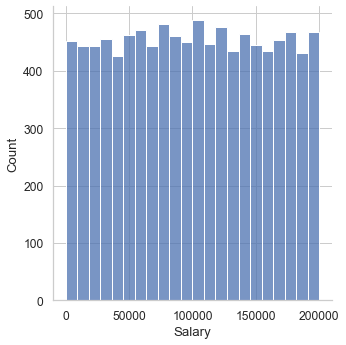

In [28]:
estimatedsalary=df['Salary']
sns.displot(estimatedsalary)
plt.show()

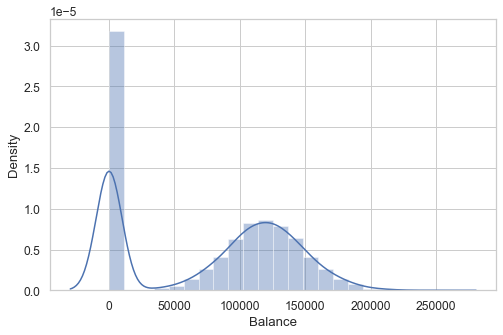

In [29]:
balance=df['Balance']
sns.distplot(balance)
plt.show()

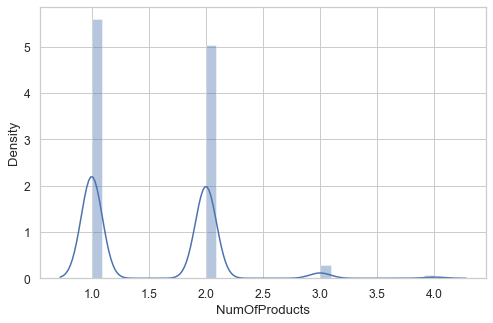

In [30]:
numofproducts=df['NumOfProducts']
sns.distplot(numofproducts)
plt.show()

#### Checking for Outliers

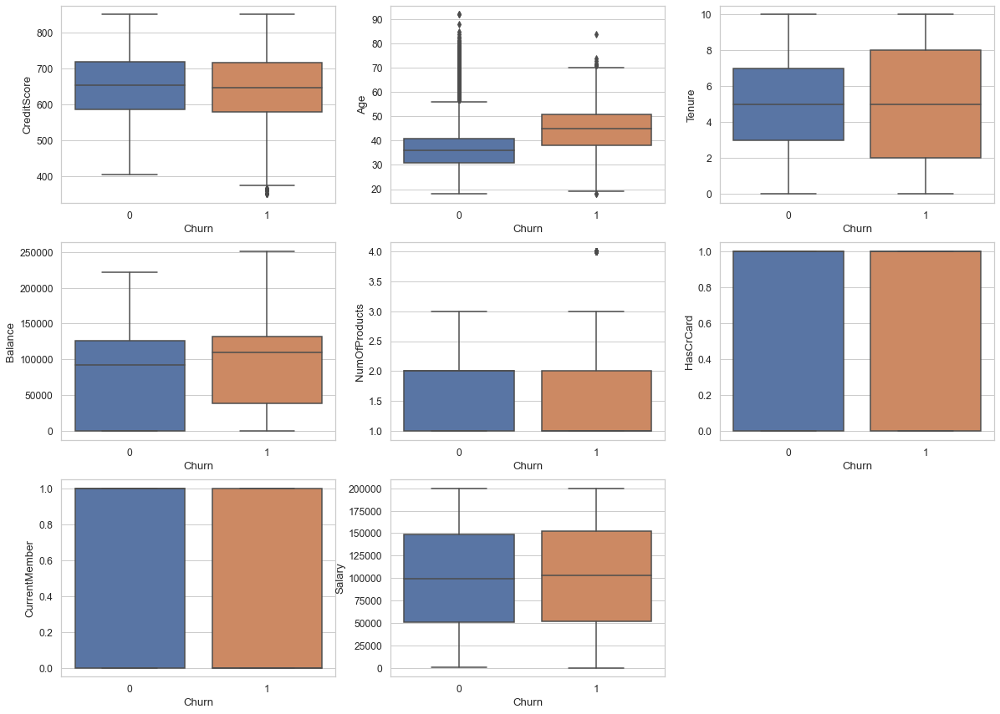

In [31]:
index = 0
plt.figure(figsize=(20,20))
for feature in numerical:
    if feature != "Churn":
        index += 1
        plt.subplot(4, 3, index)
        sns.boxplot(x='Churn', y=feature, data=df)

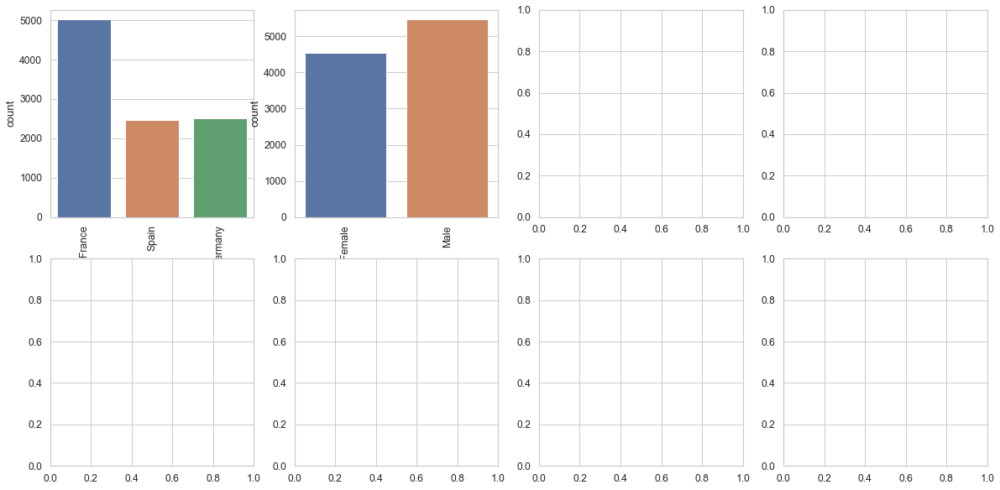

In [32]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
for variable, subplot in zip(categorical, ax.flatten()):
    sns.countplot(df[variable], ax=subplot)
    for label in subplot.get_xticklabels():
        label.set_rotation(90)

In [33]:
fig = px.box(df, y="Age", title = "Box Plot-Age")

fig.show()

### Age has outliers with several people above the upper fence age of 63 years. The oldest being 92 years

In [34]:
fig = px.box(df, y="Salary", title='Box Plot Est. Salary')

fig.show()

In [35]:
fig = px.box(df, y="Tenure", title = "Box Plot-Tenure")

fig.show()

## Data Manipulation
### Some columns names  are to long and hard to understand. These are changed. Also droped columns that have no-effect on the data like RowID, Surname and Customer ID
### Target variable(Exited)  has changed to Churn in line with context and the terminology in use

In [36]:
df.columns

Index(['CreditScore', 'Countries', 'Gender', 'Age', 'Tenure', 'Balance',
       'NumOfProducts', 'HasCrCard', 'CurrentMember', 'Salary', 'Churn'],
      dtype='object')

In [37]:
df.dtypes

CreditScore        int64
Countries         object
Gender            object
Age                int64
Tenure             int64
Balance          float64
NumOfProducts      int64
HasCrCard          int64
CurrentMember      int64
Salary           float64
Churn              int64
dtype: object

In [38]:
df.columns

Index(['CreditScore', 'Countries', 'Gender', 'Age', 'Tenure', 'Balance',
       'NumOfProducts', 'HasCrCard', 'CurrentMember', 'Salary', 'Churn'],
      dtype='object')

###  Analysing  the Target variable (Churn) and Visualize dat with respect to Churn

In [39]:
df["Churn"].unique()

array([1, 0], dtype=int64)

In [40]:
#print the count of 1 and 0 in "churn"
print(df.Churn.value_counts())

0    7963
1    2037
Name: Churn, dtype: int64


(2037, 11) (7963, 11)


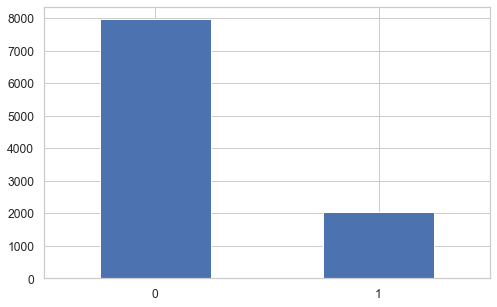

In [41]:
count_classes = pd.value_counts(df['Churn'], sort=True)
count_classes.plot(kind='bar',rot=0 )
churn = df[df['Churn']==1]
non_churn = df[df['Churn']==0]
print(churn.shape, non_churn.shape)

In [42]:
df["Churn"][df["Churn"]=="No"].groupby(by=df["Gender"]).count()

Series([], Name: Churn, dtype: int64)

In [43]:
df["Countries"].value_counts().sort_index()

France     5014
Germany    2509
Spain      2477
Name: Countries, dtype: int64

In [44]:
#Churn vs. normal 
counts = df.Churn.value_counts()
normal = counts[0]
Churn = counts[1]
perc_normal = (normal/(normal+Churn))*100
perc_Churn = (Churn/(normal+Churn))*100
print('There were {} non-Churn ({:.3f}%) and {} Churn ({:.3f}%).'.format(normal, perc_normal, Churn, perc_Churn))

There were 7963 non-Churn (79.630%) and 2037 Churn (20.370%).


Percentage of "being churn": % 20.37 --> (2037 churn cases out of 10000)
Percentage of "NOT being churn": % 79.63 --> (7963 NOT churn cases out of 10000)


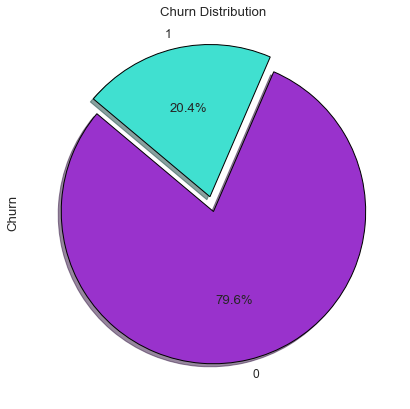

In [45]:
y = df['Churn']

print(f'Percentage of \033[1m"being churn"\033[0m: % {round(y.value_counts(normalize=True)[1]*100,2)} --> \
({y.value_counts()[1]} churn cases out of {len(df)})\nPercentage of \033[1m"NOT being churn"\033[0m: % {round(y.value_counts(normalize=True)[0]*100,2)} --> ({y.value_counts()[0]} NOT churn cases out of {len(df)})')

explode = [0, 0.1]

df["Churn"].value_counts().plot(kind="pie", 
                                 autopct='%1.1f%%', 
                                 figsize=(7, 7), 
                                 explode=explode, 
                                 wedgeprops={'edgecolor': 'black'}, 
                                 shadow=True, 
                                 colors = ['darkorchid', 'turquoise'], 
                                 startangle=140)
plt.title('Churn Distribution');

## Insights about Target variable ("Churn")
### 2037 customers left and 7963 did not Churn
### France has the largest number of customers follwed by Germany and Spain the last.
### There were 7963 non-Churn (79.630%) and 2037 Churn (20.370%)
### The data is imbalanced

In [46]:
fig = px.histogram(df, x='Age', color='Churn',nbins=80)
fig.show()

In [47]:
fig = px.histogram(df, x='CreditScore', color='Churn',nbins=80)
fig.show()

In [48]:
fig = px.histogram(df, x='Gender', color='Churn',nbins=80)
fig.show()

In [49]:
fig = px.histogram(df, x='Countries', color='Churn')
fig.show()

In [50]:
fig = px.histogram(df, x="Countries", y="Churn", color="Gender",
                   hover_data=df.columns)
fig.show()

In [51]:
fig = px.histogram(df, x="Churn", y="Countries", color="Gender", marginal="rug",
                   hover_data=df.columns)
fig.show()

In [52]:
fig = px.histogram(df, x="Countries", y="Churn", color="Gender",
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

In [53]:
fig = px.histogram(df, x="Countries", y="CreditScore", color="Churn",
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

In [54]:
fig = px.histogram(df, x='Gender', color='Countries',nbins=80)
fig.show()

In [55]:
fig = px.histogram(df, x='Tenure', color='Churn')
fig.show()

In [56]:
fig = px.histogram(df, x='NumOfProducts', color='Churn')
fig.show()

In [57]:
fig = px.histogram(df, x='HasCrCard', color='Churn')
fig.show()

In [58]:
fig = px.histogram(df, x='CurrentMember', color='Churn')
fig.show()

In [59]:
fig = px.histogram(df, x='Salary', color='Churn')
fig.show()

In [60]:
fig = px.histogram(df, x="Countries", y="Churn", color="HasCrCard",
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

In [61]:
fig = px.histogram(df, x="Countries", y="Churn", color="Gender", title="Total by Countries")
fig.show()

In [62]:
fig = px.histogram(df, x="Countries", y="Churn", color="CurrentMember", title="Total by Countries")
fig.show()

In [63]:
fig = px.histogram(df, x="Countries", y="Churn", color="CurrentMember", title="Total by Countries")
fig.show()

In [64]:
fig = px.histogram(df, x="Countries", y="Churn", color="CurrentMember", title="Total by Countries")
fig.show()

### Checking for Multicollinearity

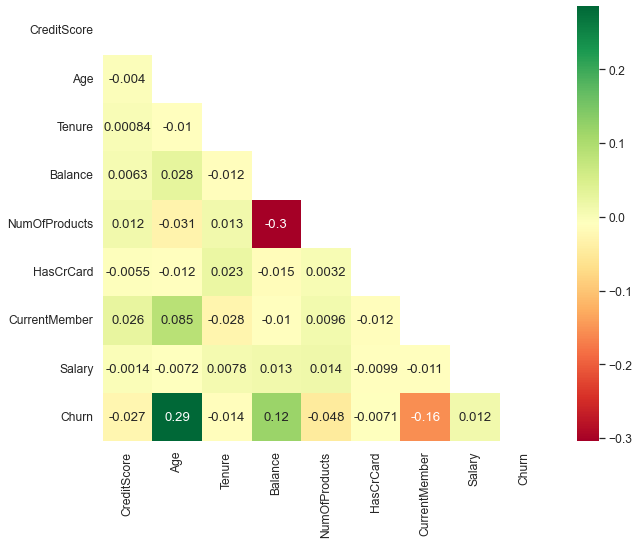

In [65]:
#get correlations of each feature in dataset
corr_matrix = df.corr()
top_corr_features = corr_matrix.index
plt.figure(figsize=(10,8))
#plot heat map
g=sns.heatmap(df[top_corr_features].corr(),annot=True,cmap="RdYlGn", mask= np.triu(df.corr()))
plt.show()

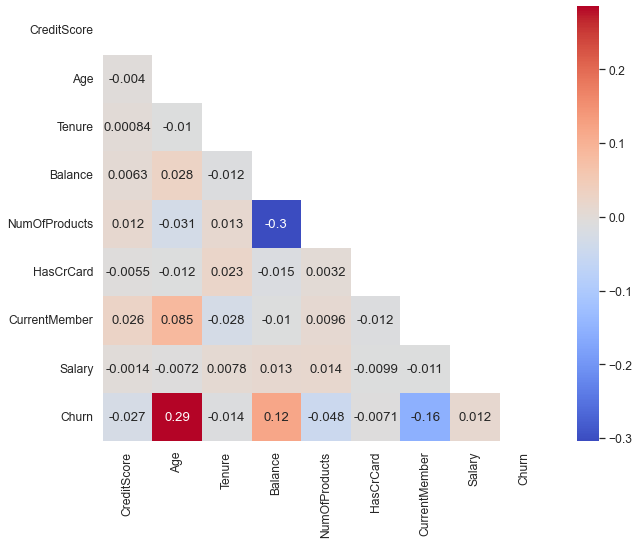

In [66]:
#get correlations of each feature in dataset
corr_matrix = df.corr()
top_corr_features = corr_matrix.index
plt.figure(figsize=(10,8))
#plot heat map
g=sns.heatmap(df.corr(),annot=True,cmap="coolwarm",mask= np.triu(df.corr()))
plt.show()

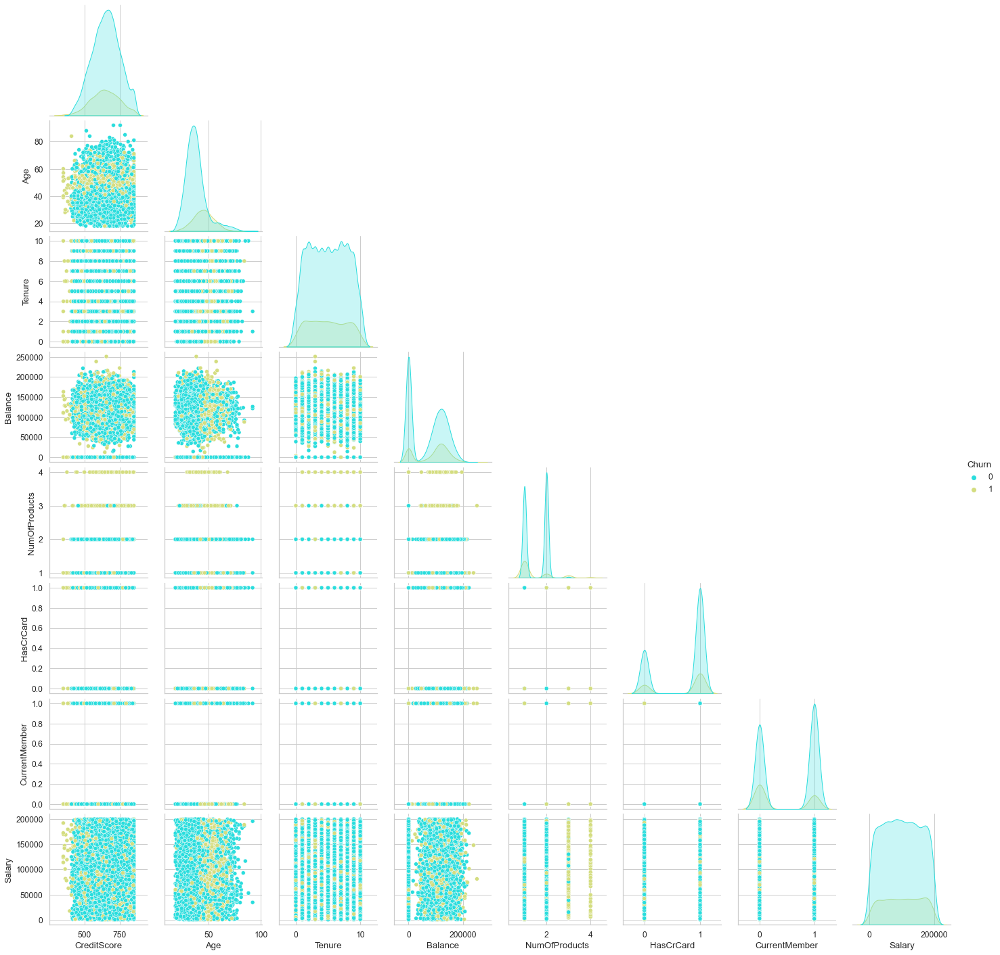

In [67]:
sns.pairplot(df, hue="Churn", palette="rainbow", corner=True);

In [68]:
df_temp = df.corr()

feature =[]
collinear=[]

for col in df_temp.columns:
    for i in df_temp.index:
        if (df_temp[col][i]> .85 and df_temp[col][i] < 1) or (df_temp[col][i]< -.85 and df_temp[col][i] > -1) :
                feature.append(col)
                collinear.append(i)
                print(Fore.RED + f"\033[1mmulticolinearity alert\033[0m between {col} - {i}")
        else:
            print(f"For {col} and {i}, there is \033[1mNO multicollinearity problem\033[0m") 

unique_list = list(set(feature+collinear))

print(colored('*'*80, 'cyan', attrs=['bold']))
print("\033[1mThe total number of strong corelated features:\033[0m", len(unique_list)) 

For CreditScore and CreditScore, there is NO multicollinearity problem
For CreditScore and Age, there is NO multicollinearity problem
For CreditScore and Tenure, there is NO multicollinearity problem
For CreditScore and Balance, there is NO multicollinearity problem
For CreditScore and NumOfProducts, there is NO multicollinearity problem
For CreditScore and HasCrCard, there is NO multicollinearity problem
For CreditScore and CurrentMember, there is NO multicollinearity problem
For CreditScore and Salary, there is NO multicollinearity problem
For CreditScore and Churn, there is NO multicollinearity problem
For Age and CreditScore, there is NO multicollinearity problem
For Age and Age, there is NO multicollinearity problem
For Age and Tenure, there is NO multicollinearity problem
For Age and Balance, there is NO multicollinearity problem
For Age and NumOfProducts, there is NO multicollinearity problem
For Age and HasCrCard, there is NO multicollinearity problem
For Age and CurrentMember,

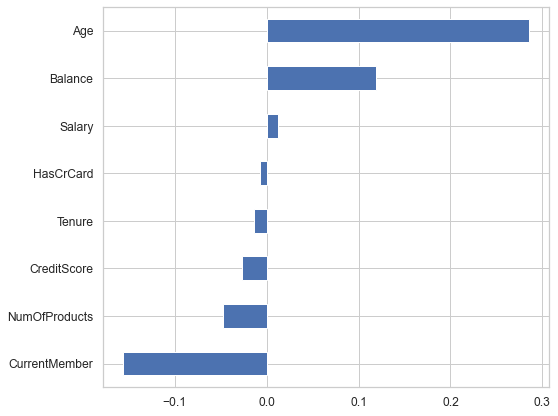

In [69]:
plt.figure(figsize = (8, 7))
df.corr()['Churn'].sort_values().drop("Churn").plot(kind = "barh");

### Multicollinearity refers to predictors that are correlated with other predictors in the model.Multicollinearity  is a problem because it can increase the variance of the coefficient estimates and make the estimates very sensitive to minor changes in the model.Good there is not Multicollinearity amognst the features.It can be concluded that there has been weak correlations between the numerical features and the target variable. However there is no multi-colliniearity problem among the variables. There is a slight negative correlation between Churn with the variables of "creditscore", "tenure", "numberofproducts" 'hascrcard' and 'isactivemember', with a slight positive correlation with the variables of 'age', 'balance' and 'estimatedsalary".

### Checking for outliers

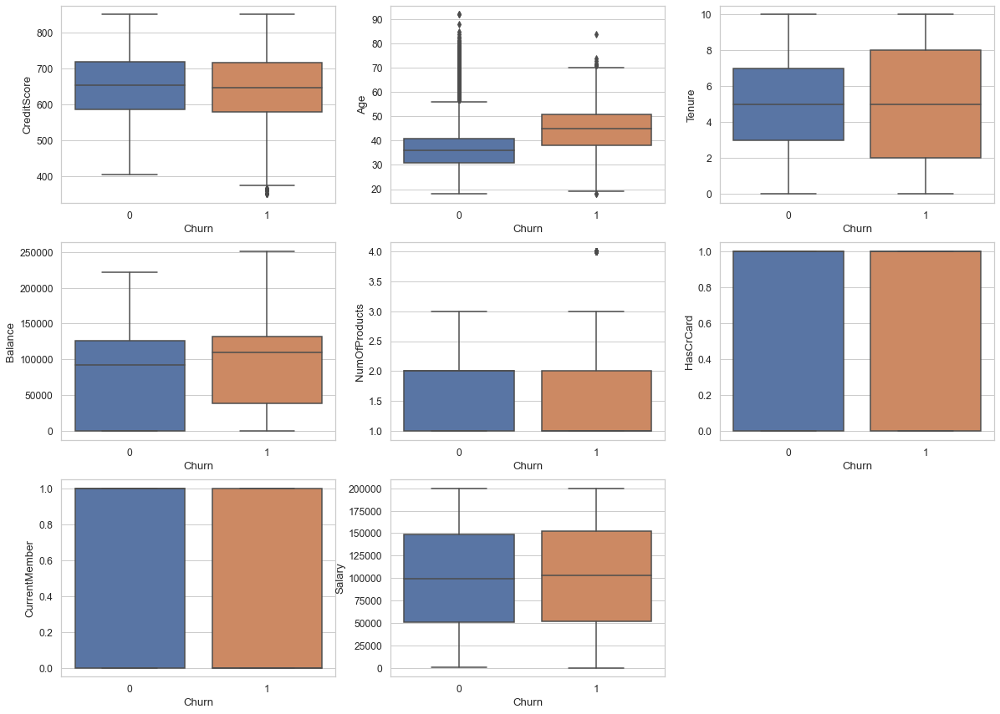

In [70]:
index = 0
plt.figure(figsize=(20,20))
for feature in numerical:
    if feature != "Churn":
        index += 1
        plt.subplot(4, 3, index)
        sns.boxplot(x='Churn', y=feature, data=df)

In [71]:
fig = px.pie(df, values='Churn', names='Gender', title="Churn by Gender")
fig.show()

In [72]:
#fig = px.pie(df, values='Churn', names='Country_France', title="Churn by France")
#fig.show()

In [73]:
#fig = px.pie(df, values='Churn', names='Country_Spain', title="Churn by Spain")
#fig.show()

In [74]:
fig = px.pie(df, values='Churn', names='Countries', title="Churn by Countries")
fig.show()

In [75]:
fig = px.pie(df, values='Churn', names='CurrentMember', title="CurrentMember")
fig.show()

In [76]:
df_cou = df.groupby(by=["Countries"]).size().reset_index(name="counts")
px.bar(df_cou,x="Countries",y="counts")

In [77]:
df_gen = df.groupby(by=["Gender"]).size().reset_index(name="counts")
px.bar(df_gen,x="Gender",y="counts")

## Data Preprocessing

In [78]:
plt.figure(figsize=(14,7))
df.corr()['Churn'].sort_values(ascending = False)

Churn            1.000000
Age              0.285323
Balance          0.118533
Salary           0.012097
HasCrCard       -0.007138
Tenure          -0.014001
CreditScore     -0.027094
NumOfProducts   -0.047820
CurrentMember   -0.156128
Name: Churn, dtype: float64

<Figure size 1008x504 with 0 Axes>

In [79]:
#There were 7963 non-Churn (79.630%) and 2037 Churn (20.370%)
#The data is imbalanced

## Spliting the data into train_test

In [80]:
X = df.drop(columns=['Churn'], axis=1)
y = df['Churn']
X_train, X_test, y_train, y_test = train_test_split(X,y,
                                                    test_size = 0.2,
                                                    random_state = 46,
                                                   stratify = y)

In [81]:
X.sample(5)

,CreditScore,Countries,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,CurrentMember,Salary
9394,597,Germany,Female,35,8,131101.04,1,1,1,192852.67
783,571,France,Female,35,8,0.00,2,0,0,84569.13
6623,581,France,Male,28,3,104367.50,1,1,1,29937.75
6111,648,France,Male,23,9,168372.52,1,1,0,134676.72
3528,692,France,Male,28,5,61581.97,1,1,1,70179.91


In [82]:
y.sample(5)

3451    0
22      1
3087    0
6582    0
2588    0
Name: Churn, dtype: int64

### Most Machine Learning Alogorithms work well with numerical data. Hence the necessary step to change categorical columns using get_dummies

In [83]:
categorical_columns = ['Gender', 'Countries']
for column in categorical_columns:
    tempdf = pd.get_dummies(df[column], prefix=column)
    df = pd.merge(
        left=df,
        right=tempdf,
        left_index=True,
        right_index=True,
    )
    df = df.drop(columns=column)
print(df)

      CreditScore  Age  Tenure    Balance  NumOfProducts  HasCrCard  \
0             619   42       2       0.00              1          1   
1             608   41       1   83807.86              1          0   
2             502   42       8  159660.80              3          1   
3             699   39       1       0.00              2          0   
4             850   43       2  125510.82              1          1   
...           ...  ...     ...        ...            ...        ...   
9995          771   39       5       0.00              2          1   
9996          516   35      10   57369.61              1          1   
9997          709   36       7       0.00              1          0   
9998          772   42       3   75075.31              2          1   
9999          792   28       4  130142.79              1          1   

      CurrentMember     Salary  Churn  Gender_Female  Gender_Male  \
0                 1  101348.88      1              1            0   
1        

In [84]:
df.head()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,CurrentMember,Salary,Churn,Gender_Female,Gender_Male,Countries_France,Countries_Germany,Countries_Spain
0,619,42,2,0.00,1,1,1,101348.88,1,1,0,1,0,0
1,608,41,1,83807.86,1,0,1,112542.58,0,1,0,0,0,1
2,502,42,8,159660.80,3,1,0,113931.57,1,1,0,1,0,0
3,699,39,1,0.00,2,0,0,93826.63,0,1,0,1,0,0
4,850,43,2,125510.82,1,1,1,79084.10,0,1,0,0,0,1


In [85]:
X = df.drop(columns=['Churn'], axis=1)
y = df['Churn']
X_train, X_test, y_train, y_test = train_test_split(X,y,
                                                    test_size = 0.2,
                                                    random_state = 46,
                                                   stratify = y)

### Model application and Evaluation

## KNN

In [86]:
knn = KNeighborsClassifier(n_neighbors = 1) 
knn.fit(X_train,y_train)
knn_preds = knn.predict(X_test)

In [87]:
y_test_pred = knn.predict(X_test)
y_test_prob = knn.predict_proba(X_test)

In [88]:
y_test_prob = knn.predict_proba(X_test)
y_test_prob

array([[1., 0.],
       [1., 0.],
       [0., 1.],
       ...,
       [0., 1.],
       [0., 1.],
       [1., 0.]])

In [89]:
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(int)
    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_score(actual, prediction))
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_score(actual, prediction))
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_score(actual, prediction))
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_score(actual, probabilities[:, 1]))
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, prediction)
    average_precision = average_precision_score(actual, prediction)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities[:, 1])
    roc_auc = auc(fpr, tpr)


    # plot
    fig, ax = plt.subplots(1, 3, figsize = (18, 6))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'Blues', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'b', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'navy', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()

In [90]:
y_train_pred = knn.predict(X_train)
y_train_prob = knn.predict_proba(X_train)
accuracy_score(y_train, y_train_pred)

1.0

Accuracy : 1.0000 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 1.0000 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 1.0000 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 1.0000                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


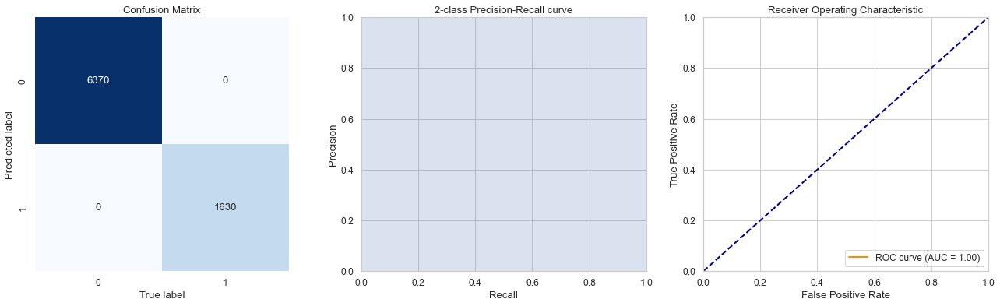

In [91]:
# show summary
show_summary_report(y_train, y_train_pred, y_train_prob)

Accuracy : 0.6670 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.1894 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.1941 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.4910                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


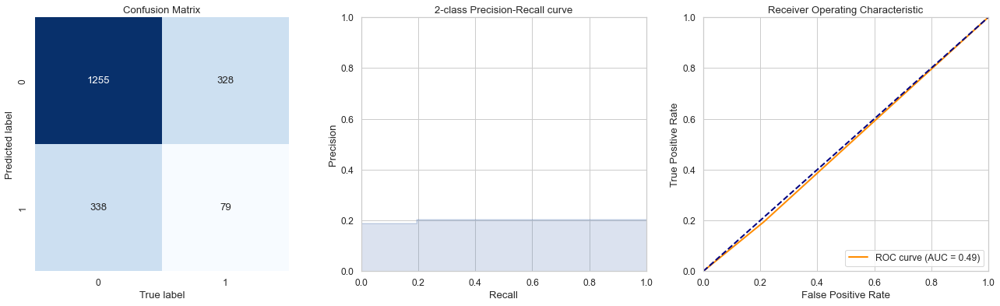

In [92]:
# show summary
show_summary_report(y_test, y_test_pred, y_test_prob)

## SVC

In [93]:
svc = SVC(random_state = 1)
svc.fit(X_train,y_train)
predictdt_y = svc.predict(X_test)
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

In [94]:
svc.fit(X_train, y_train)
score = svc.score(X_train, y_train)
print("Score: ", score)

Score:  0.79625


In [95]:
cv_scores = cross_val_score(svc, X_train, y_train, cv=10)
print("CV average score: %.2f" % cv_scores.mean())

CV average score: 0.80


In [96]:
y_pred = svc.predict(X_test)

cm = confusion_matrix(y_test, y_pred)
print(cm)

[[1593    0]
 [ 407    0]]


In [97]:
cr = classification_report(y_test, y_pred)
print(cr)

              precision    recall  f1-score   support

           0       0.80      1.00      0.89      1593
           1       0.00      0.00      0.00       407

    accuracy                           0.80      2000
   macro avg       0.40      0.50      0.44      2000
weighted avg       0.63      0.80      0.71      2000



In [98]:
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(int)
    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_score(actual, prediction))
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_score(actual, prediction))
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_score(actual, prediction))
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_score(actual, probabilities[:, 1]))
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, prediction)
    average_precision = average_precision_score(actual, prediction)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities[:, 1])
    roc_auc = auc(fpr, tpr)


    # plot
    fig, ax = plt.subplots(1, 3, figsize = (18, 6))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'Blues', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'b', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'navy', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()

In [99]:
y_train_pred = svc.predict(X_train)
y_pred = svc.predict(X_test)
accuracy_score(y_train, y_train_pred)

0.79625

Accuracy : 0.7963 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.0000 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.0000 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 1.0000                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


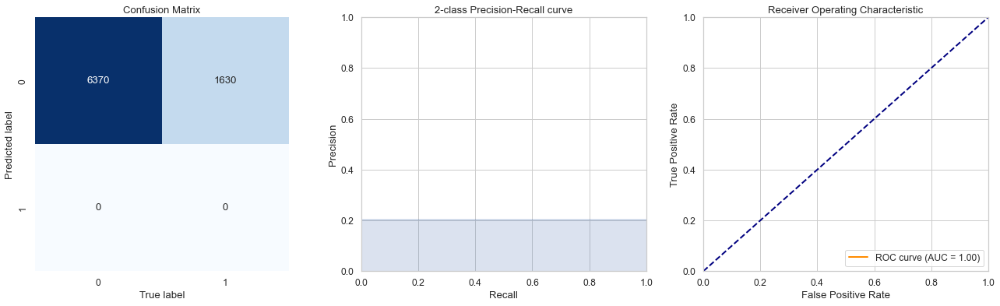

In [100]:
# show summary
show_summary_report(y_train, y_train_pred, y_train_prob)

Accuracy : 0.6670 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.1894 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.1941 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.4910                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


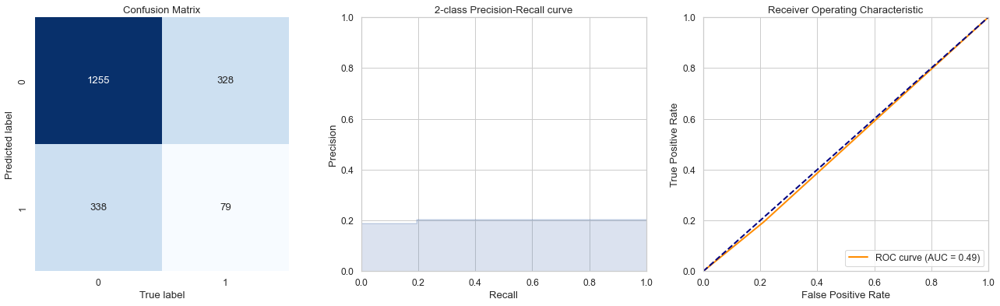

In [101]:
# show summary
show_summary_report(y_test, y_test_pred, y_test_prob)

## RandomForest Classifier

In [102]:
rfc_model = RandomForestClassifier(n_estimators=500 , oob_score = True, n_jobs = -1,
                                  random_state =50, max_features = "auto",
                                  max_leaf_nodes = 30)
rfc_model.fit(X_train,y_train)
rfc_preds = rfc_model.predict(X_test)

In [103]:
y_test_pred = rfc_model.predict(X_test)
y_test_prob = rfc_model.predict_proba(X_test)

In [104]:
y_test_prob = rfc_model.predict_proba(X_test)
y_test_prob

array([[0.8808243 , 0.1191757 ],
       [0.90205265, 0.09794735],
       [0.84780117, 0.15219883],
       ...,
       [0.53968992, 0.46031008],
       [0.8627975 , 0.1372025 ],
       [0.3183187 , 0.6816813 ]])

In [105]:
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(int)
    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_score(actual, prediction))
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_score(actual, prediction))
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_score(actual, prediction))
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_score(actual, probabilities[:, 1]))
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, prediction)
    average_precision = average_precision_score(actual, prediction)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities[:, 1])
    roc_auc = auc(fpr, tpr)


    # plot
    fig, ax = plt.subplots(1, 3, figsize = (18, 6))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'Blues', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'b', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'navy', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()

In [106]:
y_train_pred = rfc_model.predict(X_train)
y_train_prob = rfc_model.predict_proba(X_train)
accuracy_score(y_train, y_train_pred)

0.86875

Accuracy : 0.8688 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.8984 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.4012 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8755                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


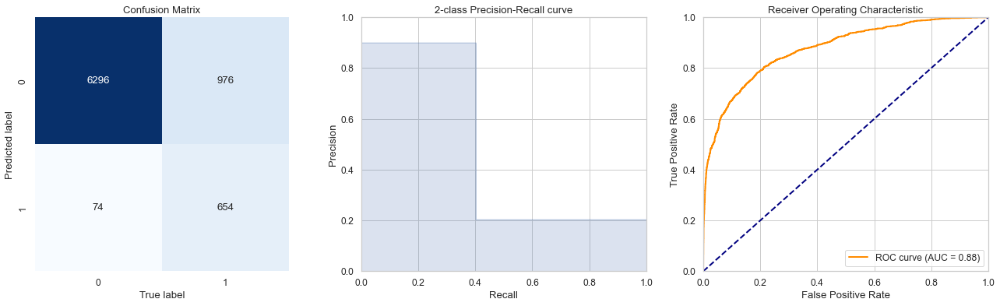

In [107]:
# show summary
show_summary_report(y_train, y_train_pred, y_train_prob)

Accuracy : 0.8495 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.7650 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.3759 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8449                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


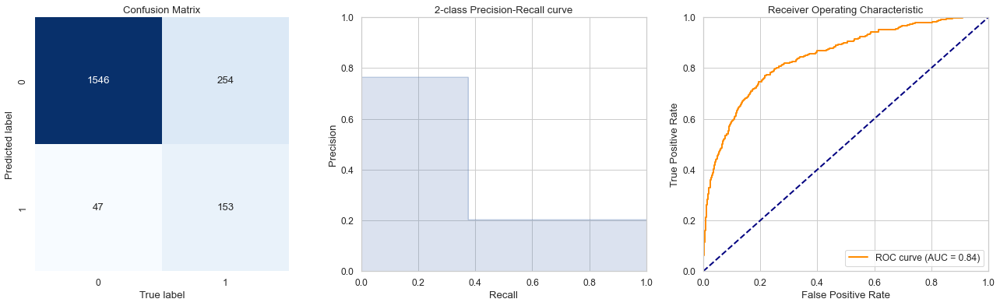

In [108]:
# show summary
show_summary_report(y_test, y_test_pred, y_test_prob)

## LogisticRegression

In [109]:
lr_model = LogisticRegression()
lr_model.fit(X_train,y_train)
lr_preds = lr_model.predict(X_test)

In [110]:
y_test_pred = lr_model.predict(X_test)
y_test_prob = lr_model.predict_proba(X_test)

In [111]:
y_test_prob = lr_model.predict_proba(X_test)
y_test_prob

array([[0.89032006, 0.10967994],
       [0.8078047 , 0.1921953 ],
       [0.77106177, 0.22893823],
       ...,
       [0.76661718, 0.23338282],
       [0.69214053, 0.30785947],
       [0.81956825, 0.18043175]])

In [112]:
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(int)
    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_score(actual, prediction))
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_score(actual, prediction))
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_score(actual, prediction))
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_score(actual, probabilities[:, 1]))
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, prediction)
    average_precision = average_precision_score(actual, prediction)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities[:, 1])
    roc_auc = auc(fpr, tpr)


    # plot
    fig, ax = plt.subplots(1, 3, figsize = (18, 6))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'Blues', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'b', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'navy', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()

In [113]:
y_train_pred = lr_model.predict(X_train)
y_train_prob = lr_model.predict_proba(X_train)
accuracy_score(y_train, y_train_pred)

0.78975

Accuracy : 0.7897 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.3968 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.0613 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.6745                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


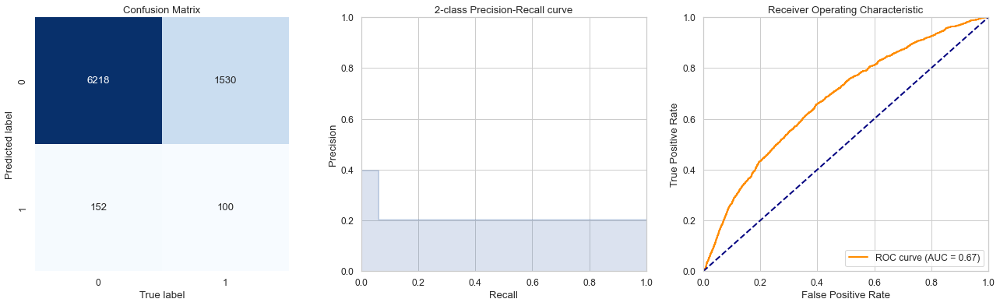

In [114]:
# show summary
show_summary_report(y_train, y_train_pred, y_train_prob)

Accuracy : 0.7915 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.4194 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.0639 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.6567                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


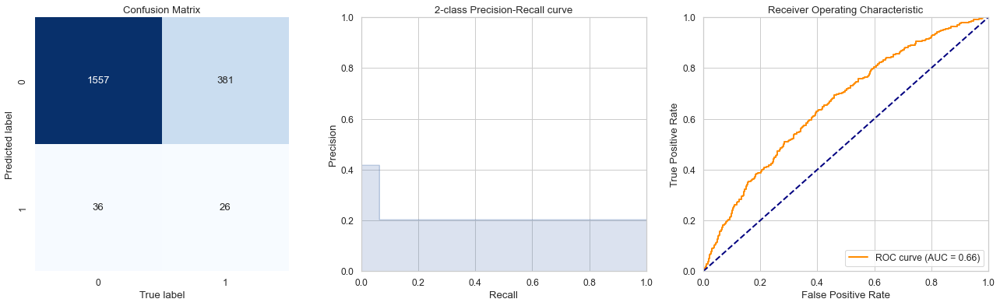

In [115]:
# show summary
show_summary_report(y_test, y_test_pred, y_test_prob)

## DecisonTreeClassifier

In [116]:
dt_model = DecisionTreeClassifier()
dt_model.fit(X_train,y_train)
dt_preds = dt_model.predict(X_test)

In [117]:
y_test_pred = dt_model.predict(X_test)
y_test_prob = dt_model.predict_proba(X_test)

In [118]:
y_test_prob = dt_model.predict_proba(X_test)
y_test_prob

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       ...,
       [0., 1.],
       [1., 0.],
       [0., 1.]])

In [119]:
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(int)
    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_score(actual, prediction))
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_score(actual, prediction))
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_score(actual, prediction))
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_score(actual, probabilities[:, 1]))
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, prediction)
    average_precision = average_precision_score(actual, prediction)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities[:, 1])
    roc_auc = auc(fpr, tpr)


    # plot
    fig, ax = plt.subplots(1, 3, figsize = (18, 6))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'Blues', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'b', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'navy', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()

In [120]:
y_train_pred = dt_model.predict(X_train)
y_train_prob = dt_model.predict_proba(X_train)
accuracy_score(y_train, y_train_pred)

1.0

Accuracy : 1.0000 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 1.0000 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 1.0000 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 1.0000                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


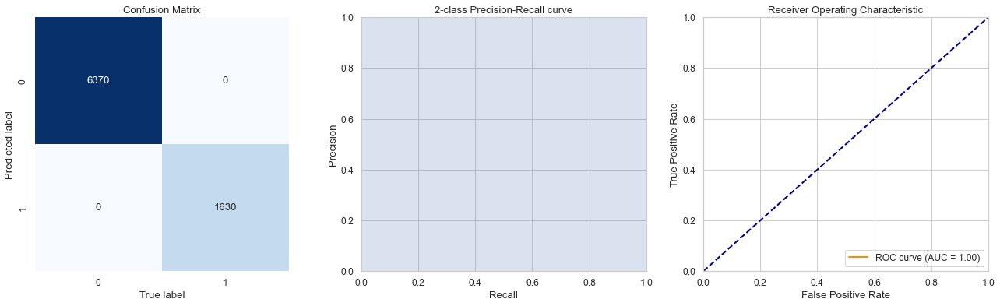

In [121]:
# show summary
show_summary_report(y_train, y_train_pred, y_train_prob)

Accuracy : 0.8045 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.5186 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.5479 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.7090                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


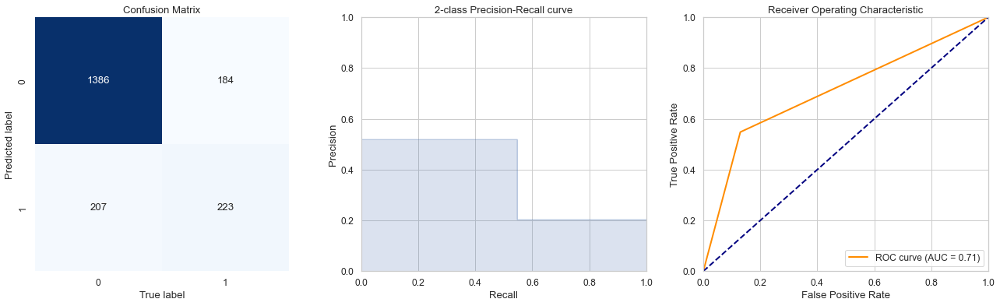

In [122]:
# show summary
show_summary_report(y_test, y_test_pred, y_test_prob)

## AdaBoostClassifier

In [123]:
#y_test_prob = a_model.predict_proba(X_test)
#y_test_prob

In [124]:
num_trees = 100
a_model = AdaBoostClassifier(n_estimators = num_trees, random_state = 46)
a_model.fit(X_train, y_train)
a_preds = a_model.predict(X_test)

In [125]:
# Evaluate model against test set
y_test_pred = a_model.predict(X_test)
y_test_prob = a_model.predict_proba(X_test)

In [126]:
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(int)
    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_score(actual, prediction))
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_score(actual, prediction))
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_score(actual, prediction))
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_score(actual, probabilities[:, 1]))
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, prediction)
    average_precision = average_precision_score(actual, prediction)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities[:, 1])
    roc_auc = auc(fpr, tpr)


    # plot
    fig, ax = plt.subplots(1, 3, figsize = (18, 6))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'Blues', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'b', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'navy', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()

In [127]:
y_train_pred = a_model.predict(X_train)
y_train_prob = a_model.predict_proba(X_train)
accuracy_score(y_train, y_train_pred)

0.863

Accuracy : 0.8630 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.7481 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.4939 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8671                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


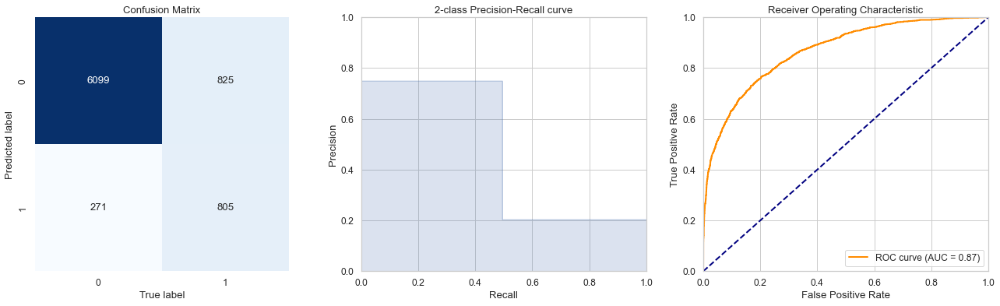

In [128]:
# show summary
show_summary_report(y_train, y_train_pred, y_train_prob)

Accuracy : 0.8430 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.6703 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.4496 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8376                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


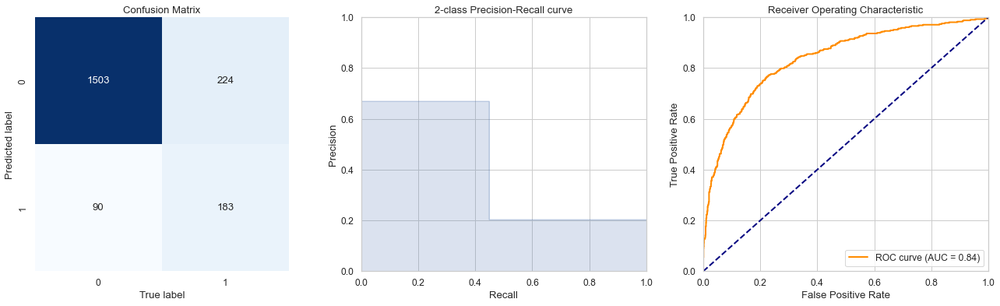

In [129]:
# show summary
show_summary_report(y_test, y_test_pred, y_test_prob)

## GradientBoostingClassifer

In [130]:
gb = GradientBoostingClassifier()
gb.fit(X_train, y_train)
gb_pred = gb.predict(X_test)

In [131]:
y_test_pred = gb.predict(X_test)
y_test_prob = gb.predict_proba(X_test)

In [132]:
y_test_prob = gb.predict_proba(X_test)
y_test_prob

array([[0.93354892, 0.06645108],
       [0.87050801, 0.12949199],
       [0.84793217, 0.15206783],
       ...,
       [0.51140291, 0.48859709],
       [0.94120687, 0.05879313],
       [0.16437855, 0.83562145]])

In [133]:
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(int)
    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_score(actual, prediction))
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_score(actual, prediction))
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_score(actual, prediction))
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_score(actual, probabilities[:, 1]))
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, prediction)
    average_precision = average_precision_score(actual, prediction)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities[:, 1])
    roc_auc = auc(fpr, tpr)


    # plot
    fig, ax = plt.subplots(1, 3, figsize = (18, 6))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'Blues', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'b', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'navy', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()

In [134]:
y_train_pred = gb.predict(X_train)
y_train_prob = gb.predict_proba(X_train)
accuracy_score(y_train, y_train_pred)

0.87775

Accuracy : 0.8778 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.8234 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.5092 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8902                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


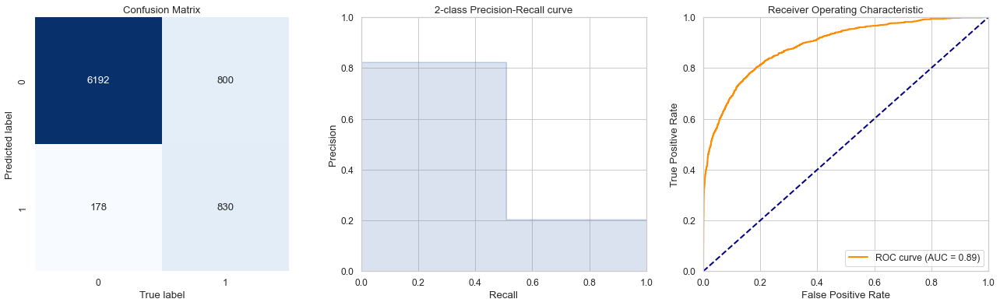

In [135]:
# show summary
show_summary_report(y_train, y_train_pred, y_train_prob)

Accuracy : 0.8505 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.7109 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.4472 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8602                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


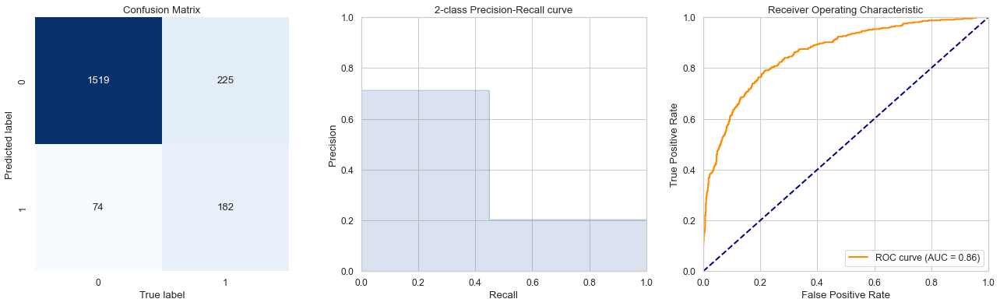

In [136]:
# show summary
show_summary_report(y_test, y_test_pred, y_test_prob)

## XGBoostClassier

In [137]:
xgb_model = xgb.XGBClassifier(max_depth=3, learning_rate=0.1, n_estimators=500, objective='binary:logistic', booster='gbtree')


In [138]:
xgb_model.fit(X_train,y_train)

xgb_preds = xgb_model.predict(X_test)

In [139]:
y_test_pred = xgb_model.predict(X_test)
y_test_prob = xgb_model.predict_proba(X_test)

In [140]:
y_test_prob = xgb_model.predict_proba(X_test)
y_test_prob

array([[0.8621528 , 0.13784716],
       [0.8605652 , 0.13943484],
       [0.88312674, 0.11687324],
       ...,
       [0.29234904, 0.70765096],
       [0.9617516 , 0.03824844],
       [0.15439099, 0.845609  ]], dtype=float32)

In [141]:
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(int)
    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_score(actual, prediction))
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_score(actual, prediction))
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_score(actual, prediction))
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_score(actual, probabilities[:, 1]))
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, prediction)
    average_precision = average_precision_score(actual, prediction)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities[:, 1])
    roc_auc = auc(fpr, tpr)


    # plot
    fig, ax = plt.subplots(1, 3, figsize = (18, 6))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'Blues', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'b', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'navy', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()

In [142]:
y_train_pred = xgb_model.predict(X_train)
y_train_prob = xgb_model.predict_proba(X_train)
accuracy_score(y_train, y_train_pred)

0.89925

Accuracy : 0.8992 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.8801 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.5853 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9326                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


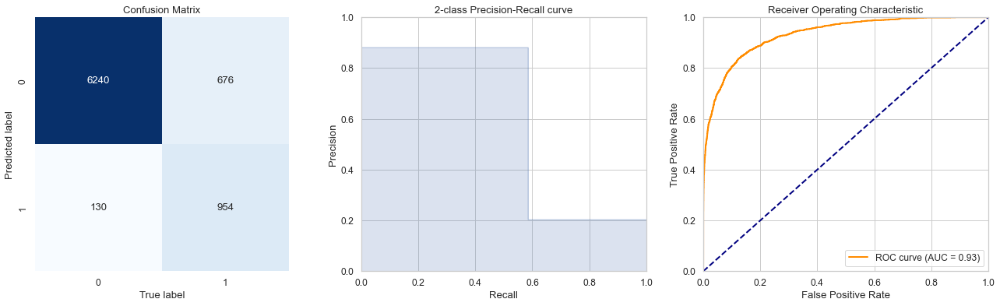

In [143]:
# show summary
show_summary_report(y_train, y_train_pred, y_train_prob)

Accuracy : 0.8465 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.6799 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.4644 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8561                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


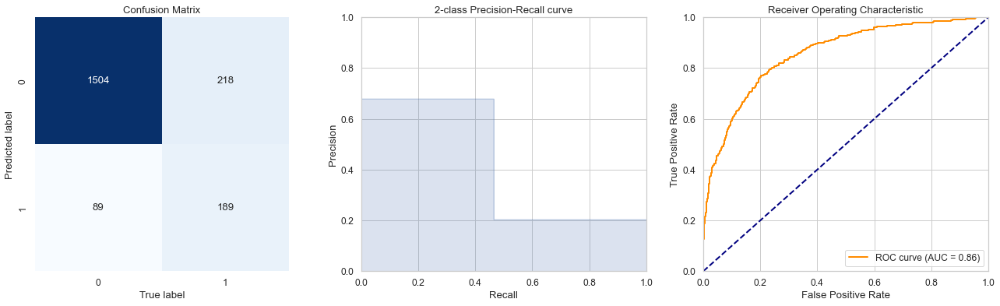

In [144]:
# show summary
show_summary_report(y_test, y_test_pred, y_test_prob)

## CatBoostClassifier

In [145]:
cat_model = CatBoostClassifier(verbose=False)
cat_model.fit(X_train,y_train)
cat_preds = cat_model.predict(X_test)


In [146]:
y_test_pred = cat_model.predict(X_test)
y_test_prob = cat_model.predict_proba(X_test)

In [147]:
y_test_prob = cat_model.predict_proba(X_test)
y_test_prob

array([[0.89061625, 0.10938375],
       [0.86325998, 0.13674002],
       [0.89131538, 0.10868462],
       ...,
       [0.41650647, 0.58349353],
       [0.90161599, 0.09838401],
       [0.2404524 , 0.7595476 ]])

In [148]:
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(int)
    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_score(actual, prediction))
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_score(actual, prediction))
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_score(actual, prediction))
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_score(actual, probabilities[:, 1]))
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, prediction)
    average_precision = average_precision_score(actual, prediction)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities[:, 1])
    roc_auc = auc(fpr, tpr)


    # plot
    fig, ax = plt.subplots(1, 3, figsize = (18, 6))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'Blues', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'b', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'navy', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()

In [149]:
y_train_pred = cat_model.predict(X_train)
y_train_prob = cat_model.predict_proba(X_train)
accuracy_score(y_train, y_train_pred)

0.910375

Accuracy : 0.9104 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9043 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.6264 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9496                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


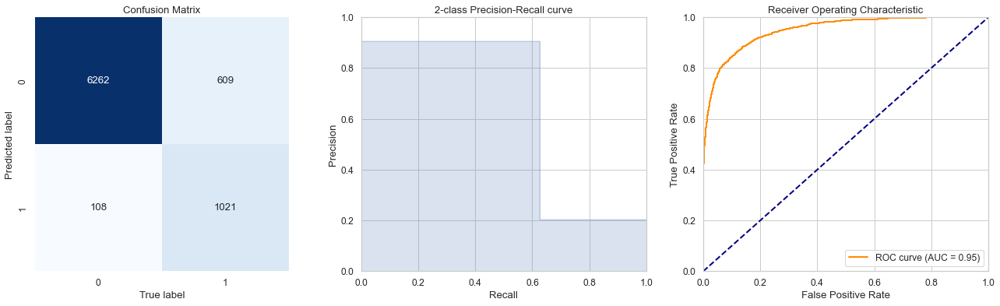

In [150]:
# show summary
show_summary_report(y_train, y_train_pred, y_train_prob)

Accuracy : 0.8535 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.7050 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.4816 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8624                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


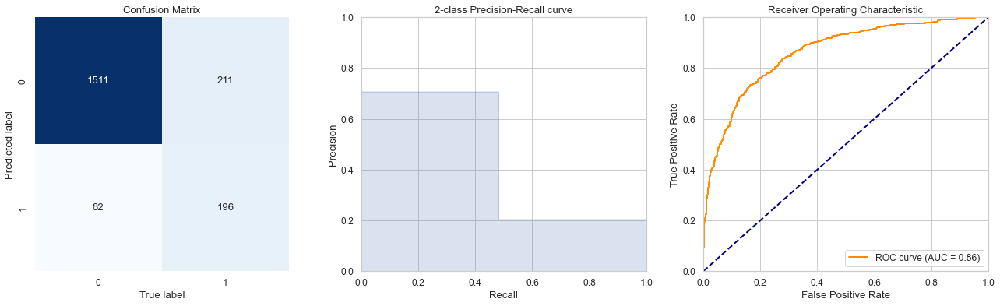

In [151]:
# show summary
show_summary_report(y_test, y_test_pred, y_test_prob)

In [152]:
from sklearn.model_selection import GridSearchCV
from catboost import CatBoostClassifier

cat_model = CatBoostClassifier(verbose=False)

parameters = {'depth'         : [4,5,6,7,8,9, 10],
                 'learning_rate' : [0.01,0.02,0.03,0.04],
                  'iterations'    : [10, 20,30,40,50,60,70,80,90, 100]
                 }

Grid_cat_model = GridSearchCV(estimator=cat_model, param_grid = parameters, cv = 2, n_jobs=-1)
Grid_cat_model.fit(X_train, y_train)


GridSearchCV(cv=2,
             estimator=<catboost.core.CatBoostClassifier object at 0x000001DC3522F910>,
             n_jobs=-1,
             param_grid={'depth': [4, 5, 6, 7, 8, 9, 10],
                         'iterations': [10, 20, 30, 40, 50, 60, 70, 80, 90,
                                        100],
                         'learning_rate': [0.01, 0.02, 0.03, 0.04]})

In [153]:
print(" Results from Grid Search " )
print("\n The best estimator across ALL searched params:\n",Grid_cat_model.best_estimator_)
print("\n The best score across ALL searched params:\n",Grid_cat_model.best_score_)
print("\n The best parameters across ALL searched params:\n",Grid_cat_model.best_params_)


 Results from Grid Search 

 The best estimator across ALL searched params:

 The best score across ALL searched params:
 0.8668750000000001

 The best parameters across ALL searched params:
 {'depth': 7, 'iterations': 80, 'learning_rate': 0.04}


### Running CatboostClassifier after GriSearchCV to identify parameters

In [154]:
from catboost import CatBoostClassifier

cat_model = CatBoostClassifier(depth=6, iterations=100, learning_rate=0.04,verbose=False)

parameters = {'depth'         : [4,5,6,7,8,9, 10],
                 'learning_rate' : [0.01,0.02,0.03,0.04],
                  'iterations'    : [10, 20,30,40,50,60,70,80,90, 100]
                 }


Accuracy : 0.8535 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.7050 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.4816 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8624                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


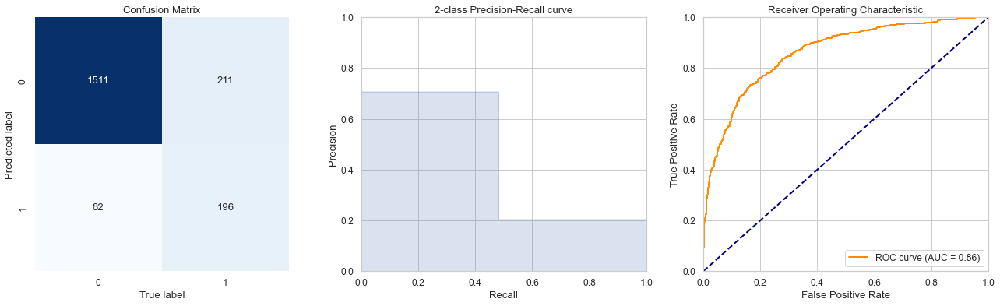

In [155]:
# show summary
show_summary_report(y_test, y_test_pred, y_test_prob)

### No change in results without parameters and with specified parameters

In [156]:
cat_model = CatBoostClassifier(depth=6, iterations=100, learning_rate=0.04, verbose=False)
cat_model.fit(X_train,y_train)
cat_preds = cat_model.predict(X_test)

In [157]:
y_test_pred = cat_model.predict(X_test)
y_test_prob = cat_model.predict_proba(X_test)

In [158]:
y_test_prob = cat_model.predict_proba(X_test)
y_test_prob

array([[0.9053462 , 0.0946538 ],
       [0.86058764, 0.13941236],
       [0.82335537, 0.17664463],
       ...,
       [0.47144549, 0.52855451],
       [0.90846473, 0.09153527],
       [0.18257028, 0.81742972]])

In [159]:
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(int)
    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_score(actual, prediction))
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_score(actual, prediction))
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_score(actual, prediction))
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_score(actual, probabilities[:, 1]))
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, prediction)
    average_precision = average_precision_score(actual, prediction)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities[:, 1])
    roc_auc = auc(fpr, tpr)


    # plot
    fig, ax = plt.subplots(1, 3, figsize = (18, 6))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'Blues', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'b', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'navy', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()

Accuracy : 0.8480 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.7052 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.4349 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8554                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


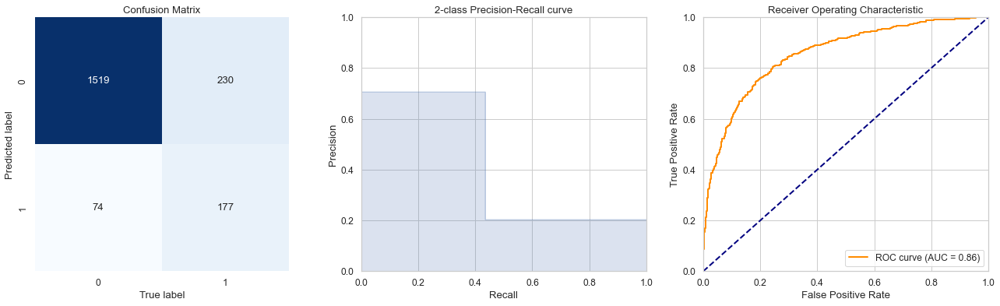

In [160]:
# show summary
show_summary_report(y_test, y_test_pred, y_test_prob)

In [161]:
list_train = [['KNN', 'Accuracy : 0.7990 ', 'Precision: 0.5585', 'Recall   : 0.0644', 'ROC AUC  : 0.7314 '],
              ['SVC', 'Accuracy : 0.7963 ', 'Precision: 0.0000', 'Recall   : 0.0000 ', 'ROC AUC  : 0.7314 '],
              ['RFC', 'Accuracy : 0.8686', 'Precision: 0.8960', 'Recall   : 0.4018', 'ROC AUC  : 0.8764'],
              ['LogR', 'Accuracy : 0.7897', 'Precision: 0.3968', 'Recall   : 0.0613', 'ROC AUC  : 0.6745'],
              ['DTC', 'Accuracy : 1.0000', 'Precision: 1.0000', 'Recall   : 1.0000', 'ROC AUC  : 1.0000'],
              ['ABC', 'Accuracy : 0.8630', 'Precision: 0.7481', 'Recall   : 0.4939', 'ROC AUC  : 0.8671'],
              ['GBC', 'Accuracy : 0.8778', 'Precision: 0.8234', 'Recall   : 0.5092', 'ROC AUC  : 0.8902'],
              ['XGB', 'Accuracy : 0.8992', 'Precision: 0.8801', 'Recall   : 0.5853', 'ROC AUC  : 0.9326'],
              ['CBC', 'Accuracy : 0.9103', 'Precision: 0.9035 ', 'Recall   : 0.6264', 'ROC AUC  : 0.9504 ']]

In [162]:
df1 = pd.DataFrame(list_train)
df1

,0,1,2,3,4
0,KNN,Accuracy : 0.7990,Precision: 0.5585,Recall : 0.0644,ROC AUC : 0.7314
1,SVC,Accuracy : 0.7963,Precision: 0.0000,Recall : 0.0000,ROC AUC : 0.7314
2,RFC,Accuracy : 0.8686,Precision: 0.8960,Recall : 0.4018,ROC AUC : 0.8764
3,LogR,Accuracy : 0.7897,Precision: 0.3968,Recall : 0.0613,ROC AUC : 0.6745
4,DTC,Accuracy : 1.0000,Precision: 1.0000,Recall : 1.0000,ROC AUC : 1.0000
5,ABC,Accuracy : 0.8630,Precision: 0.7481,Recall : 0.4939,ROC AUC : 0.8671
6,GBC,Accuracy : 0.8778,Precision: 0.8234,Recall : 0.5092,ROC AUC : 0.8902
7,XGB,Accuracy : 0.8992,Precision: 0.8801,Recall : 0.5853,ROC AUC : 0.9326
8,CBC,Accuracy : 0.9103,Precision: 0.9035,Recall : 0.6264,ROC AUC : 0.9504


In [163]:
list_test = [['KNN','Accuracy : 0.7905 ', 'Precision: 0.3500', 'Recall   : 0.0344', 'ROC AUC  : 0.5370' ],
      ['SVC','Accuracy : 0.7905', 'Precision: 0.3500', 'Recall   : 0.0344', 'ROC AUC  : 0.5370'],
      ['RFC','Accuracy : 0.8480 ', 'Precision: 0.7562', 'Recall   : 0.3735', 'ROC AUC  : 0.8461'],
      ['LogR', 'Accuracy : 0.7915', 'Precision: 0.4194', 'Recall   : 0.0639', 'ROC AUC  : 0.6567'],
      ['DTC','Accuracy : 0.8040 ', 'Precision: 0.5172', 'Recall   : 0.5528', 'ROC AUC  : 0.7105'],
      ['ABC', 'Accuracy : 0.8430', 'Precision: 0.6703','Recall   : 0.4496', 'ROC AUC  : 0.8376 '],
      ['GBC', 'Accuracy : 0.8505 ','Precision: 0.7109','Recall   : 0.4472', 'ROC AUC  : 0.8602 '],
      ['XGB', 'Accuracy : 0.8465', 'Precision: 0.6799', 'Recall   : 0.4644','ROC AUC  : 0.8561 '],
      ['CBC','Accuracy : 0.8485 ', 'Precision: 0.6898', 'Recall   : 0.4644 ', 'ROC AUC  : 0.8621 ']]

In [164]:
#create pandas DataFrame
df2 = pd.DataFrame(list_test)
df2

,0,1,2,3,4
0,KNN,Accuracy : 0.7905,Precision: 0.3500,Recall : 0.0344,ROC AUC : 0.5370
1,SVC,Accuracy : 0.7905,Precision: 0.3500,Recall : 0.0344,ROC AUC : 0.5370
2,RFC,Accuracy : 0.8480,Precision: 0.7562,Recall : 0.3735,ROC AUC : 0.8461
3,LogR,Accuracy : 0.7915,Precision: 0.4194,Recall : 0.0639,ROC AUC : 0.6567
4,DTC,Accuracy : 0.8040,Precision: 0.5172,Recall : 0.5528,ROC AUC : 0.7105
5,ABC,Accuracy : 0.8430,Precision: 0.6703,Recall : 0.4496,ROC AUC : 0.8376
6,GBC,Accuracy : 0.8505,Precision: 0.7109,Recall : 0.4472,ROC AUC : 0.8602
7,XGB,Accuracy : 0.8465,Precision: 0.6799,Recall : 0.4644,ROC AUC : 0.8561
8,CBC,Accuracy : 0.8485,Precision: 0.6898,Recall : 0.4644,ROC AUC : 0.8621


In [165]:
# prepare configuration for cross validation test harness
seed = 9
# prepare models
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
results = []
names = []
outcome = []
model_names = []
models = [('LR', LogisticRegression()),
          ('RFC', RandomForestClassifier()),
          ('KNN', KNeighborsClassifier()),
          ('DTC', DecisionTreeClassifier()),
          ('ABC', AdaBoostClassifier()),
          ('SVC', SVC()),
          ('GBC', GradientBoostingClassifier()),
          ('XGB', XGBClassifier()),
          ('CBC', CatBoostClassifier(verbose=False))]


In [166]:
for model_name, model in models:
    k_fold_validation = KFold(n_splits=10, random_state=None)
    results = cross_val_score(model, X, y, cv=k_fold_validation, scoring='accuracy')
    outcome.append(results)
    model_names.append(model_name)
    output_message = "%s| Mean=%f STD=%f" % (model_name, results.mean(), results.std())
    print(output_message)

LR| Mean=0.789800 STD=0.006645
RFC| Mean=0.861700 STD=0.009056
KNN| Mean=0.765000 STD=0.009088
DTC| Mean=0.787200 STD=0.011125
ABC| Mean=0.858300 STD=0.006435
SVC| Mean=0.796300 STD=0.010479
GBC| Mean=0.865100 STD=0.009628
XGB| Mean=0.853900 STD=0.006503
CBC| Mean=0.864100 STD=0.007049


In [167]:
# Application of all Machine Learning methods
models = []
models.append(('LR', LogisticRegression()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('RFC', RandomForestClassifier()))
models.append(('ABC', AdaBoostClassifier()))
models.append(('DTC', DecisionTreeClassifier()))
models.append(('GBC', GradientBoostingClassifier()))
models.append(('SVM', SVC()))
models.append(('XGB', XGBClassifier()))
models.append(('CBC', CatBoostClassifier(verbose=False)))

CBC: 0.868500 (0.010980)


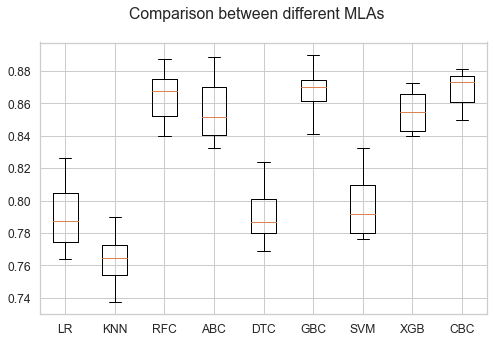

In [168]:
# evaluate each model in turn
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
results = []
names = []
scoring = 'accuracy'
for name, model in models:
    kfold = model_selection.KFold(n_splits=10, random_state=None)
    cv_results = model_selection.cross_val_score(model, X_train, y_train, cv=kfold, scoring=scoring)
    results.append(cv_results)
    names.append(name)
    msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
print(msg)
# boxplot algorithm comparison
fig = plt.figure()
fig.suptitle('Comparison between different MLAs')
ax = fig.add_subplot(111)
plt.boxplot(results)
ax.set_xticklabels(names)
plt.show()

In [169]:
algo = [lr_model, knn, rfc_model, a_model, dt_model , gb, svc, xgb_model, cat_model]
model=[]
accuracy_test=[]
accuracy_train=[]
recall_train=[]
recall_test=[]
for i in range(len(algo)):
    algo[i].fit(X_train,y_train)
    accuracy_train.append(algo[i].score(X_train,y_train))
    accuracy_test.append(algo[i].score(X_test,y_test))
    y_pred=algo[i].predict(X_train)
    y_test_pred=algo[i].predict(X_test)
    recall_train.append(recall_score(y_train, y_pred, average='macro'))
    recall_test.append(recall_score(y_test, y_test_pred, average='macro'))
    model.append(algo[i])

In [170]:
# Import required libraries for performance metrics
from sklearn.metrics import make_scorer
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.model_selection import cross_validate

# Define dictionary with performance metrics
scorer = {'accuracy':make_scorer(accuracy_score), 
           'precision':make_scorer(precision_score),
           'recall':make_scorer(recall_score), 
           'f1_score':make_scorer(f1_score)}

# Import required libraries for machine learning classifiers
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB

# Instantiate the machine learning classifiers
log_model = LogisticRegression(max_iter=10000)
svc_model = LinearSVC(dual=False)
dtr_model = DecisionTreeClassifier()
rfc_model = RandomForestClassifier()
gnb_model = GaussianNB()

# Define the models evaluation function
def models_evaluation(X, y, folds):
    
    
    X : df.drop(columns=['Churn'], axis=1)
    y : df['Churn']
    

In [173]:
from sklearn.model_selection import cross_validate
from sklearn.model_selection import KFold, StratifiedKFold, train_test_split, cross_validate, cross_val_score
# Perform cross-validation to each machine learning classifier
scoring=['accuracy','recall','precision']
cv = 5

rfc_model = RandomForestClassifier(n_estimators=500 , oob_score = True, n_jobs = -1,
                                  random_state =50, max_features = "auto",
                                  max_leaf_nodes = 30)
a_model = AdaBoostClassifier(n_estimators = num_trees, random_state = 46)
cat_model = CatBoostClassifier(verbose=False)
lr_model = LogisticRegression() 
svc = SVC(random_state = 1)
dt_model = DecisionTreeClassifier()
gb = GradientBoostingClassifier()
xgb_model =XGBClassifier(max_depth=3, learning_rate=0.1, n_estimators=500, objective='binary:logistic', booster='gbtree')


lr = cross_validate(lr_model, X, y, cv=cv, scoring=scoring)
svc = cross_validate(svc, X, y, cv=cv, scoring=scoring)
dt = cross_validate(dt_model, X, y, cv=cv, scoring=scoring)
rfc = cross_validate(rfc_model, X, y, cv=cv, scoring=scoring)
gb = cross_validate(gb, X, y, cv=cv, scoring=scoring)
xgb = cross_validate(xgb_model, X, y, cv=cv, scoring=scoring)
abc = cross_validate(a_model, X, y, cv=cv, scoring=scoring)
cbc = cross_validate(cat_model, X, y, cv=cv, scoring=scoring)

# Create a data frame with the models perfoamnce metrics scores
models_scores_table = pd.DataFrame({'LR':[lr['test_accuracy'].mean(),
                                                               lr['test_precision'].mean(),
                                                               lr['test_recall'].mean()],
                                                               
                                       
                                      'SVC':[svc['test_accuracy'].mean(),
                                                                   svc['test_precision'].mean(),
                                                                   svc['test_recall'].mean()],
                                                                   
                                       
                                      'DT':[dt['test_accuracy'].mean(),
                                                       dt['test_precision'].mean(),
                                                       dt['test_recall'].mean()],
                                                       
                                       
                                      'RF':[rfc['test_accuracy'].mean(),
                                                       rfc['test_precision'].mean(),
                                                       rfc['test_recall'].mean()],
                                                       
                                       
                                       
                                       'GB':[gb['test_accuracy'].mean(),
                                                              gb['test_precision'].mean(),
                                                              gb['test_recall'].mean()],
                                                              
                                    
                                        'XGB':[xgb['test_accuracy'].mean(),
                                                              xgb['test_precision'].mean(),
                                                              xgb['test_recall'].mean()],
                                                              
                                       
                                       'ABC':[abc['test_accuracy'].mean(),
                                                              abc['test_precision'].mean(),
                                                              abc['test_recall'].mean()],
                                                              
                                       
                                       'CBC':[cbc['test_accuracy'].mean(),
                                                              cbc['test_precision'].mean(),
                                                              cbc['test_recall'].mean()]},
                                       
                                       
                                       
                                       
                                       
                                       
                                       
                                      
                                      index=['Accuracy', 'Precision', 'Recall'])
    
# Add 'Best Score' column
models_scores_table['Best Score'] = models_scores_table.idxmax(axis=1)
    



In [174]:
models_scores_table

,LR,SVC,DT,RF,GB,XGB,ABC,CBC,Best Score
Accuracy,0.790300,0.7963,0.791100,0.855500,0.864200,0.865000,0.858000,0.865700,CBC
Precision,0.397260,0.0000,0.487743,0.849198,0.772858,0.758051,0.733353,0.764820,RF
Recall,0.057431,0.0000,0.517924,0.353956,0.472261,0.495828,0.476677,0.493369,DT


### Balancing the Data
### AS we noted earlier on the data is imbalanced and applying Machine Learning (ML) without manipulating the data will compromise the accuracy of the Alogorithms. We apply SMOTETomek library to balance the data before applying ML Alogorithms

In [175]:
from imblearn.combine import SMOTETomek
smk = SMOTETomek()
x_res,y_res = smk.fit_resample(X,y)
x_res.shape, y_res.shape

((13716, 13), (13716,))

In [176]:
from collections import Counter
print('Original dataset shape{}'.format(Counter(y)))
print('Resampled dataset shape{}'.format(Counter(y_res)))

Original dataset shapeCounter({0: 7963, 1: 2037})
Resampled dataset shapeCounter({0: 6858, 1: 6858})


In [177]:
cat_model = CatBoostClassifier(depth=6, iterations=100, learning_rate=0.04, verbose=False)
x_res,y_res = smk.fit_resample(X,y)
cat_model.fit(x_res,y_res)
cat_preds = cat_model.predict(X_test)

In [178]:
cat_preds = cat_model.predict(X_test)
cat_preds

array([0, 0, 0, ..., 1, 0, 1], dtype=int64)

In [179]:
y_test_prob = cat_model.predict_proba(X_test)
y_test_prob

array([[0.81952026, 0.18047974],
       [0.78414735, 0.21585265],
       [0.61507914, 0.38492086],
       ...,
       [0.41299775, 0.58700225],
       [0.8224051 , 0.1775949 ],
       [0.10158431, 0.89841569]])

Accuracy : 0.8390 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.6071 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.5921 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8595                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


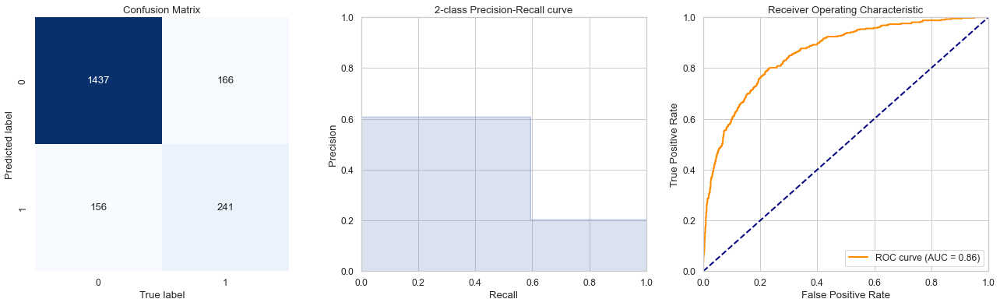

In [180]:
# show summary
show_summary_report(y_test, cat_preds, y_test_prob)

In [181]:
#Accuracy : 0.8480 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
#Precision: 0.7052 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
#Recall   : 0.4349 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
#ROC AUC  : 0.8554       

In [182]:
### Comparing Catboost scores before and after balancing data

#### Before
#Accuracy : 0.8480 
#Precision: 0.7052  
#Recall   : 0.4349 
#ROC AUC  : 0.8554 

#### After
#Accuracy : 0.8385 
#Precision: 0.6061 
#Recall   : 0.5897 
#ROC AUC  : 0.8592

## Summary
#### Of the ML alogorithms used CatBoostClassifier topped the rank, followed by Random Forest, and Decision tree in third place.
#### Data was imbalanced and used SMOTETokem to balance the data
#### Applying balanced data on Catboost Alogorithm to improve the precision and recall scores returned a slight reduced Accurance, Precision , but improved recall by about 16%
#### CatBoost alogorithym can still predict Customer Churn with 84% Accuraracy, Pecision 61% and Recall 59% and with 86% of the data as area under the curve(i.e. 86% of the data is included).



### Bonus ideas 
### where feature selection is needed we can use the following. This is however not applicable for this project since there are just 11 important features. Applying feature selection where there are a few features will cause data leakage resulting errors in calculations.

In [183]:
# Show feature importance
import shap

In [184]:
#load JS visualization code to notebook
shap.initjs()

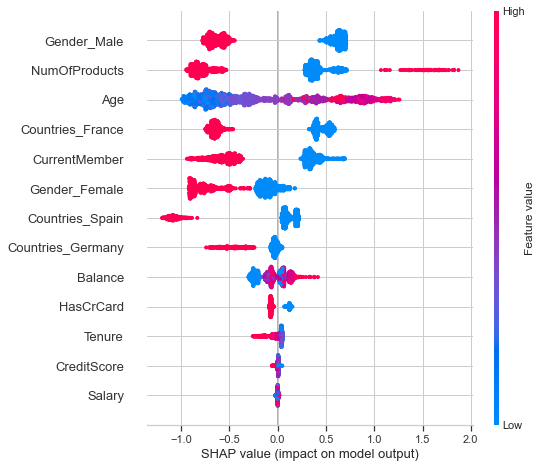

In [185]:
#show summary plots
ex = shap.TreeExplainer(cat_model)
shap_values = ex.shap_values(X_test)
shap.summary_plot(shap_values, X_test)

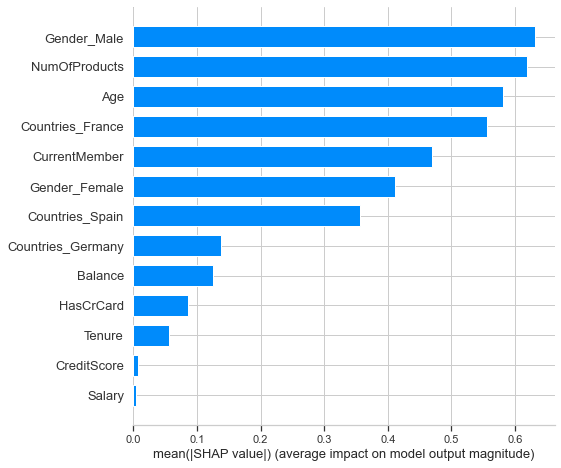

In [186]:
shap_values = shap.TreeExplainer(cat_model).shap_values(X_train)
shap.summary_plot(shap_values, X_train, plot_type="bar")